In [1]:
import pandas as pd
import numpy as np
import dataprep
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv('book_data.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1796 entries, 0 to 1795
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   product_id      1796 non-null   int64  
 1   title           1796 non-null   object 
 2   authors         1653 non-null   object 
 3   original_price  1796 non-null   int64  
 4   current_price   1796 non-null   int64  
 5   quantity        1751 non-null   float64
 6   category        1796 non-null   object 
 7   n_review        1796 non-null   int64  
 8   avg_rating      1796 non-null   float64
 9   pages           1546 non-null   object 
 10  manufacturer    1523 non-null   object 
 11  cover_link      1796 non-null   object 
dtypes: float64(2), int64(4), object(6)
memory usage: 168.5+ KB


In [4]:
df.head()

,product_id,title,authors,original_price,current_price,quantity,category,n_review,avg_rating,pages,manufacturer,cover_link
0,74021317,Cây Cam Ngọt Của Tôi,José Mauro de Vasconcelos,108000,64800,53075.0,Tiểu Thuyết,11481,5.0,244,Nhà Xuất Bản Hội Nhà Văn,https://salt.tikicdn.com/ts/product/5e/18/24/2...
1,74021317,Cây Cam Ngọt Của Tôi,José Mauro de Vasconcelos,108000,64800,53075.0,Tiểu Thuyết,11481,5.0,244,Nhà Xuất Bản Hội Nhà Văn,https://salt.tikicdn.com/ts/product/5e/18/24/2...
2,184466860,Hành Tinh Của Một Kẻ Nghĩ Nhiều,Nguyễn Đoàn Minh Thư,86000,59900,7929.0,Sách tư duy - Kỹ năng sống,780,4.8,184,Nhà Xuất Bản Thế Giới,https://salt.tikicdn.com/ts/product/d7/99/24/1...
3,73787185,Những Tù Nhân Của Địa Lý,Tim Marshall,210000,126000,17896.0,Lĩnh vực khác,3623,4.8,430,Nhà Xuất Bản Hội Nhà Văn,https://salt.tikicdn.com/ts/product/8d/96/9e/c...
4,52789367,Nhà Giả Kim (Tái Bản 2020),Paulo Coelho,79000,47400,24668.0,Tác phẩm kinh điển,5131,5.0,228,Nhà Xuất Bản Hà Nội,https://salt.tikicdn.com/ts/product/45/3b/fc/a...


In [5]:
df.tail()

,product_id,title,authors,original_price,current_price,quantity,category,n_review,avg_rating,pages,manufacturer,cover_link
1791,192949122,7 Thói Quen Hiệu Quả - The 7 Habits Of Highly ...,Stephen R Covey,250000,191200,76.0,Sách tư duy - Kỹ năng sống,7,5.0,NaN,Nhà Xuất Bản Tổng hợp TP.HCM,https://salt.tikicdn.com/ts/product/ba/c3/c0/1...
1792,157579054,Các Vấn Đề Của Triết Học (The Problems Of Phil...,Bertrand Russell,85000,48900,147.0,Triết Học,20,5.0,236,Nhà Xuất Bản Khoa Học Xã Hội,https://salt.tikicdn.com/ts/product/a5/52/7f/3...
1793,20704715,Để Con Được Chích - Hiểu Hết Về Vắc Xin Và Miễ...,Uyên Bùi,108000,43200,931.0,Sách Làm Cha Mẹ,47,4.6,296,NaN,https://salt.tikicdn.com/ts/product/05/15/e0/1...
1794,131144753,Nhà Lãnh Đạo 360 Độ (Tái Bản),John C. Maxwell,179000,107500,378.0,"Sách quản trị, lãnh đạo",33,5.0,436,Nhà Xuất Bản Lao Động,https://salt.tikicdn.com/ts/product/fd/bd/40/8...
1795,58971672,The Best of Chicken Soup - Tuyển Tập Những Câu...,Jack Canfield,138000,91000,954.0,Sách nghệ thuật sống đẹp,176,5.0,256,Nhà Xuất Bản Tổng hợp TP.HCM,https://salt.tikicdn.com/media/catalog/product...


In [6]:
df.describe()

,product_id,original_price,current_price,quantity,n_review,avg_rating
count,1.796000e+03,1.796000e+03,1.796000e+03,1751.000000,1796.000000,1796.000000
mean,1.157510e+08,1.583232e+05,1.150219e+05,2860.978869,341.213252,4.584187
std,7.263814e+07,1.265108e+05,1.013725e+05,16942.100425,791.537654,1.152097
min,3.353370e+05,0.000000e+00,0.000000e+00,1.000000,0.000000,0.000000
25%,5.262294e+07,8.900000e+04,6.000000e+04,173.500000,16.000000,4.800000
50%,1.136198e+08,1.290000e+05,8.868500e+04,566.000000,75.000000,4.800000
75%,1.925312e+08,1.890000e+05,1.365000e+05,2151.000000,306.250000,5.000000
max,2.079098e+08,1.550000e+06,1.200000e+06,671121.000000,11481.000000,5.000000


  0%|          | 0/1724 [00:00<?, ?it/s]

DataPrep Report
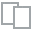
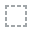
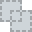
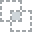
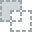
...
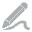
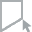
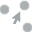
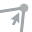
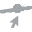

In [7]:
from dataprep.eda import create_report, plot
report = create_report(df)
report

In [8]:
# Loại bỏ trùng lặp, giữ lại bản ghi đầu tiên của mỗi product_id
df = df.drop_duplicates(subset='product_id', keep='first')
df.shape

(1777, 12)

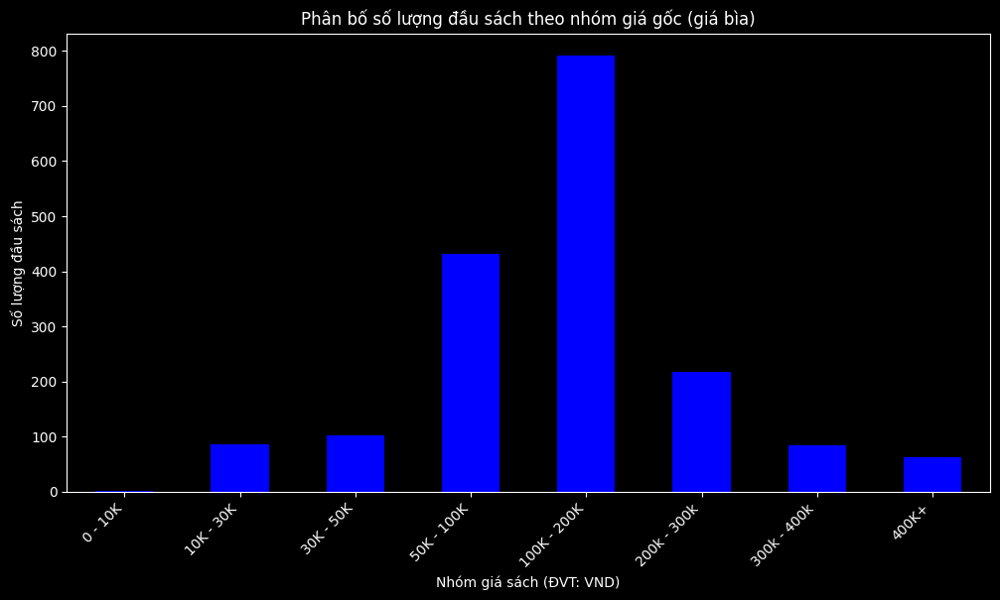

In [9]:
# Chia khoản giá sách gốc
bins = [0, 10000, 30000, 50000, 100000, 200000, 300000, 400000, df['original_price'].max()]
labels = ["0 - 10K", "10K - 30K", "30K - 50K", "50K - 100K", "100K - 200K", "200k - 300k", "300k - 400k", "400K+"]

# Phân loại sách theo nhóm giá gốc
df['price_group'] = pd.cut(df['original_price'], bins=bins, labels=labels, include_lowest=True)

# Đếm số lượng đầu sách trong mỗi nhóm giá
price_distribution = df['price_group'].value_counts().sort_index()

# Vẽ biểu đồ phân bố
plt.figure(figsize=(12, 6))
price_distribution.plot(kind='bar', color='blue')
plt.xlabel("Nhóm giá sách (ĐVT: VND)")
plt.ylabel("Số lượng đầu sách")
plt.title("Phân bố số lượng đầu sách theo nhóm giá gốc (giá bìa)")
plt.xticks(rotation=45, ha='right')
plt.show()



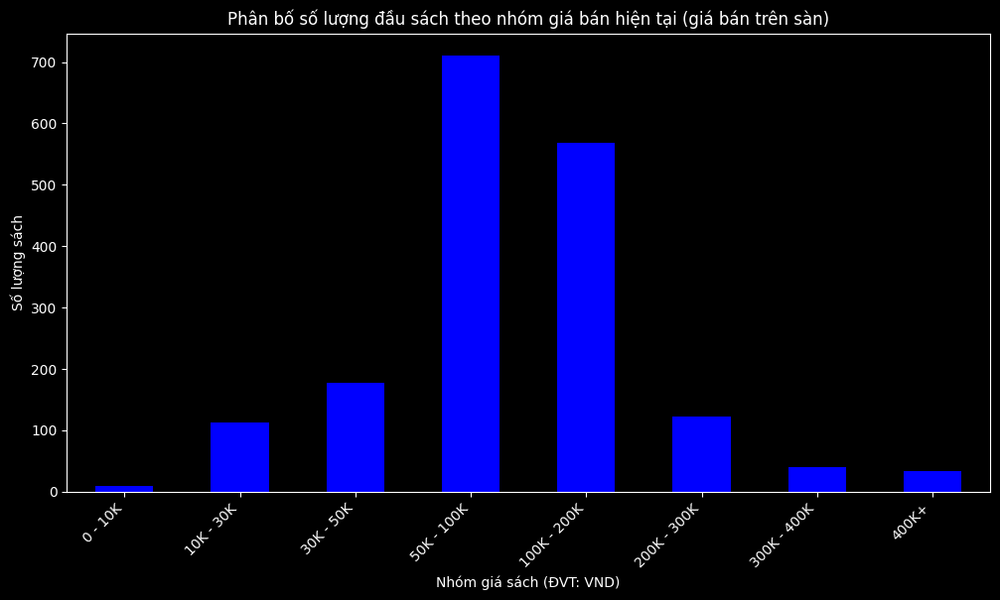

In [10]:
# Chia các khoản giá
bins = [0, 10000, 30000, 50000, 100000, 200000, 300000, 400000, df['current_price'].max()]
labels = ["0 - 10K", "10K - 30K", "30K - 50K", "50K - 100K", "100K - 200K", "200K - 300K", "300K - 400K", "400K+"]

# Phân loại sách theo nhóm giá hiện tại
df['current_price_group'] = pd.cut(df['current_price'], bins=bins, labels=labels, include_lowest=True)

# Đếm số lượng đầu sách trong mỗi nhóm giá hiện tại
current_price_distribution = df['current_price_group'].value_counts().sort_index()

# Vẽ biểu đồ phân bố
plt.figure(figsize=(12, 6))
current_price_distribution.plot(kind='bar', color='blue')
plt.xlabel("Nhóm giá sách (ĐVT: VND)")
plt.ylabel("Số lượng sách")
plt.title("Phân bố số lượng đầu sách theo nhóm giá bán hiện tại (giá bán trên sàn)")
plt.xticks(rotation=45, ha='right')
plt.show()

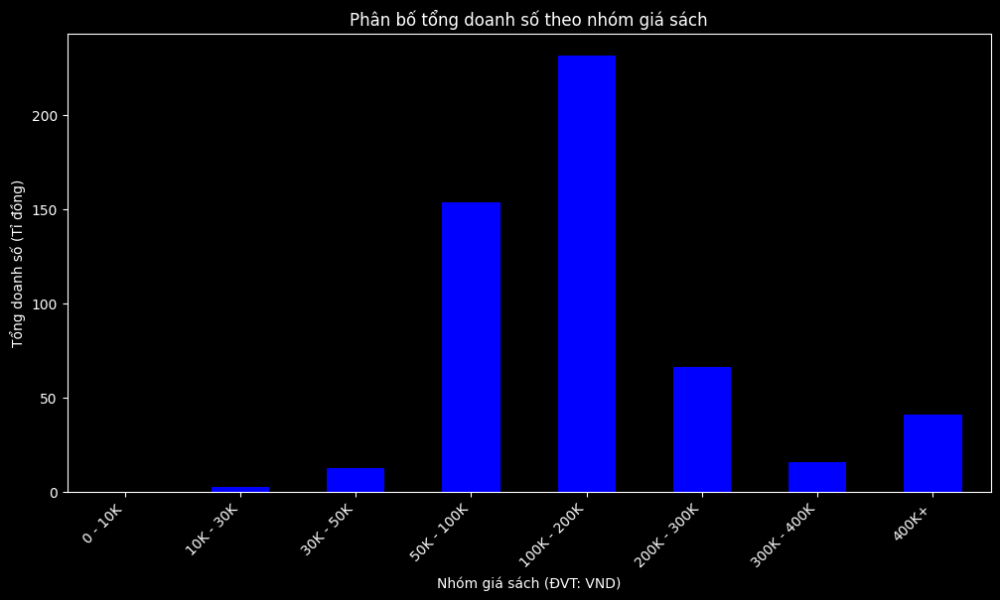

In [11]:
# Tính doanh số bán ra (doanh số) theo tác giả
df['revenue'] = df['current_price'] * df['quantity']
# Xác định các khoảng giá sách
bins = [0, 10000, 30000, 50000, 100000, 200000, 300000, 400000, df['current_price'].max()]
labels = ["0 - 10K", "10K - 30K", "30K - 50K", "50K - 100K", "100K - 200K", "200K - 300K", "300K - 400K", "400K+"]

# Phân loại sách theo nhóm giá hiện tại
df['current_price_group'] = pd.cut(df['current_price'], bins=bins, labels=labels, include_lowest=True)

# Tính tổng doanh sốho từng nhóm giá (đơn vị: tỉ đồng)
revenue_distribution = df.groupby('current_price_group')['revenue'].sum() / 1_000_000_000

# Vẽ biểu đồ doanh số theo nhóm giá sách (đơn vị: tỉ đồng)
plt.figure(figsize=(12, 6))
revenue_distribution.plot(kind='bar', color='blue')  
plt.xlabel("Nhóm giá sách (ĐVT: VND)")
plt.ylabel("Tổng doanh số (Tỉ đồng)")
plt.title("Phân bố tổng doanh số theo nhóm giá sách")
plt.xticks(rotation=45, ha='right')
plt.show()

### 1. Phân tích sự phân bổ về nhóm giá sách trên sàn

Một cuốn sách có mức giá bao nhiêu sẽ thu hút được nhiều người mua nhất? Đây không chỉ là mối quan tâm của bạn đọc mà còn là bài toán quan trọng đối với các nhà xuất bản và nhà bán lẻ. Giá sách cần được đặt ở mức hợp lý—không quá đắt để tránh làm giảm sức mua, nhưng cũng không quá rẻ đến mức ảnh hưởng đến lợi nhuận hay giá trị của sách.


Dữ liệu từ nền tảng thương mại điện tử cho thấy sự phân bổ giá sách theo hai góc độ: giá gốc và giá bán thực tế sau khi được chiết khấu. Khi phân tích hai yếu tố này, kèm theo doanh số cụ thể cho từng nhóm giá có thể rút ra những chiến lược quan trọng trong việc định giá sách.


✨Nhóm giá phổ biến theo giá gốc (giá niêm yết)

Xét theo mức giá bìa ban đầu, sách trên sàn thương mại điện tử chủ yếu tập trung vào ba nhóm chính:


1. 100K - 200K VND: Đây là nhóm chiếm số lượng đầu sách lớn nhất với gần 800 đầu sách.

2. 50K - 100K VND: Mức giá này cũng có số lượng đầu sách đáng kể, khoảng 500 đầu sách.

3. 200K - 300K VND: Dù số lượng sách trong nhóm này thấp hơn hai nhóm trên, nhưng lại có điểm đáng chú ý: nhiều cuốn sách có giá bìa cao nhưng sau đó được giảm giá đáng kể.


✨Nhóm giá phổ biến theo giá bán (sau chiết khấu)

Dữ liệu giá bán thực tế sau khi áp dụng các chương trình khuyến mãi cho thấy sự thay đổi đáng kể:


1. 50K - 100K VND: Trở thành nhóm có nhiều đầu sách nhất, với hơn 700 đầu sách.

2. 100K - 200K VND: Giảm xuống vị trí thứ hai với gần 600 đầu sách.

3. 30K - 50K VND: Xuất hiện một nhóm giá thấp hơn với khoảng 200 đầu sách.


✨Nhóm giá có doanh số bán cao nhất:

1. 100K - 200K VND: Đây là nhóm có doanh số cao nhất với tổng doanh số hơn 200 tỉ

2. 50K - 100K VND: Đây là nhóm có doanh số cao thứ nhì với tổng doanh số là hơn 150 tỉ

3. 200k - 300K VND: Đây là nhóm có doanh số cao thứ ba với tổng doanh số trên 50 tỉ


💡Có một sự thay đổi đáng kể khi so sánh giữa giá gốc và giá bán thực tế. Ban đầu, nhóm 100K - 200K VND có nhiều đầu sách nhất, nhưng sau khi giảm giá, nhóm 50K - 100K VND mới là nơi tập trung lượng đầu sách cao nhất. Điều này phản ánh chiến lược chiết khấu mạnh mẽ, giúp sách tiếp cận nhiều khách hàng hơn.

💡Xu hướng này cũng xuất hiện ở các mức giá cao hơn. Chẳng hạn, sách có giá bìa 200K - 300K VND thường được giảm xuống mức thấp hơn, giúp chúng dễ tiêu thụ hơn so với giá gốc. Điều này cho thấy giá bán thực tế trên sàn thường thấp hơn giá niêm yết, tạo ra lợi thế cạnh tranh so với các nhà sách truyền thống.

💡Nếu bình tĩnh đánh giá qua sự phân bổ về doanh số theo giá nhóm sách có thể thấy, rẻ cũng chưa chắc là tối ưu. Nhóm sách nằm trong vùng giá 100K - 200K tuy chỉ đứng thứ 2 về số lượng đầu sách thực tế nhưng lại là nhóm có tổng doanh số cao nhất.

#### 🔎Chiến lược giá dành cho nhà xuất bản:

📌Mức giá 50K - 100K VND là phân khúc hấp dẫn nhất, với số lượng đầu sách và giao dịch cao nhất. Mức giá này có thể dùng tạo độ phủ cho thương hiệu của nhà xuất bản.

📌Mức giá 100K - 200K VND cũng chiếm tỷ trọng lớn và là mức giá phổ biến của nhiều sách trước khi chiết khấu. Đây là vùng giá chiến lược tạo lợi nhuận cho nhà xuất bản nếu tối ưu được. 

📌Khi đưa sách lên sàn, nhà xuất bản cần cân nhắc mức giá bìa và chính sách giảm giá sao cho phù hợp với hai vùng giá này, giúp sách dễ dàng tiếp cận người mua hơn. Mức giảm giá sách cần cân nhắc xem xét yếu tố tăng trưởng doanh số cụ thể theo thời gian của đầu sách đó để tránh giảm giá sớm gây mất lợi nhuận tối ưu.


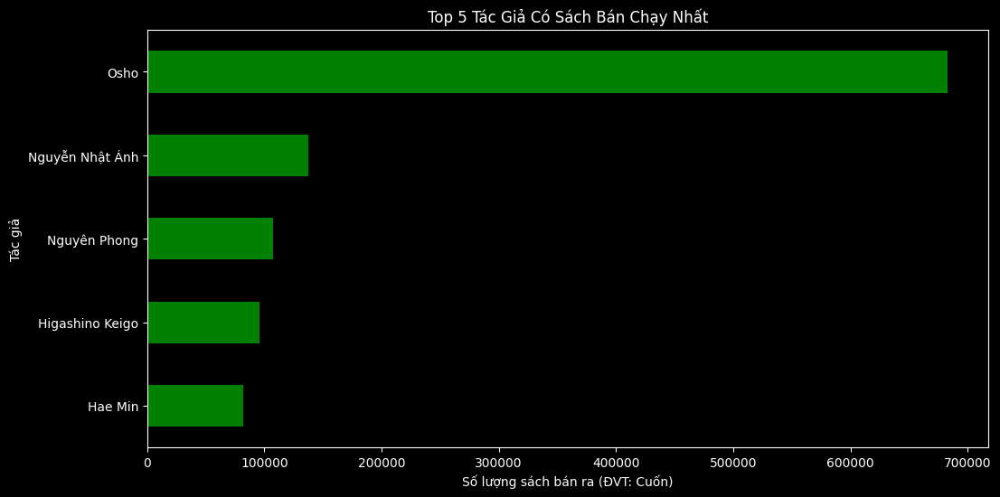

In [12]:
# Nhóm dữ liệu theo tác giả và tính tổng số lượng sách bán ra
top_authors = df.groupby('authors')['quantity'].sum().sort_values(ascending=False).head(5)

# Vẽ biểu đồ top 5 tác giả có sách bán chạy (số lượng tồn kho cao nhất)
plt.figure(figsize=(12, 6))
top_authors.plot(kind='barh', color='green')
plt.xlabel("Số lượng sách bán ra (ĐVT: Cuốn)")
plt.ylabel("Tác giả")
plt.title("Top 5 Tác Giả Có Sách Bán Chạy Nhất")
plt.gca().invert_yaxis()  # Đưa tác giả có số lượng cao nhất lên trên
plt.show()


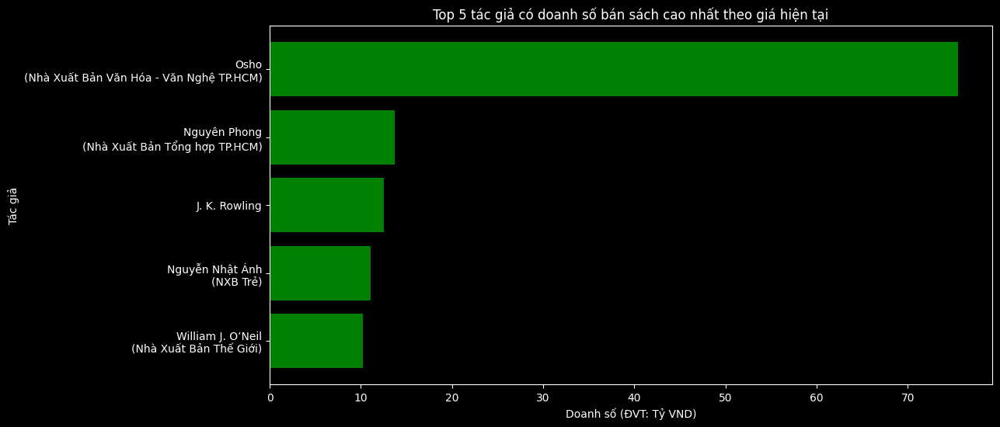

In [13]:
# Tính doanh số bán ra (doanh số) theo tác giả
df['revenue'] = df['current_price'] * df['quantity']
author_revenue = df.groupby('authors')['revenue'].sum().sort_values(ascending=False).head(5)
# Vẽ biểu đồ cột ngang
author_revenue = author_revenue / 1_000_000_000

# Lấy thông tin nhà xuất bản cho các tác giả
author_publishers = df.drop_duplicates(subset='authors').set_index('authors')['manufacturer']

# Tạo nhãn mới kết hợp tên tác giả và nhà xuất bản
author_labels = [
    f"{author}\n({author_publishers[author]})" if pd.notna(author_publishers[author]) else f"{author}"
    for author in author_revenue.index
]

# Vẽ biểu đồ cột ngang
plt.figure(figsize=(12, 6))
plt.barh(author_labels, author_revenue, color='green')
plt.xlabel("Doanh số (ĐVT: Tỷ VND)")
plt.ylabel("Tác giả")
plt.title("Top 5 tác giả có doanh số bán sách cao nhất theo giá hiện tại")
plt.gca().invert_yaxis()  # Đảo ngược trục để tác giả có doanh số cao nhất nằm trên cùng

# Hiển thị biểu đồ
plt.show()

### 2. Phân tích doanh số theo tác giả

Trong thị trường sách, có một câu hỏi thú vị: Một nhà xuất bản có thể thành công nhờ một tác giả "đinh" không?

Hãy nhìn vào bảng xếp hạng các tác giả có lượng sách bán ra nhiều nhất:

1. Osho

2. Nguyễn Nhật Ánh

3. Nguyên Phong

Và danh sách các tác giả có doanh số cao nhất:

1. Osho (NXB Văn Hoá – Văn Nghệ TP.HCM)

2. Nguyên Phong (NXB Tổng Hợp TP.HCM)

3. J.K. Rowling (Không có NXB độc quyền tại Việt Nam)

💡Sự khác biệt giữa hai danh sách này cho thấy một điều: Không phải cứ tác giả bán được nhiều sách là doanh số cao.

💡Nguyễn Nhật Ánh – Sách bán chạy nhưng chưa chắc doanh số cao
Sách của Nguyễn Nhật Ánh luôn được đông đảo bạn đọc yêu thích. Nhưng dù số lượng sách bán ra rất lớn, ông lại không lọt vào top 3 doanh số. Điều này có thể do giá sách của ông không quá cao, dù được mua nhiều nhưng ddoanh số chưa bứt phá.

💡Nguyên Phong – Ít sách hơn nhưng giá trị cao
Trong khi đó, Nguyên Phong bán ít sách hơn Nguyễn Nhật Ánh nhưng lại đứng trên về doanh số. Những cuốn sách của ông thường có giá trị cao hơn, nên tổng doanh số cũng tăng theo.

💡J.K. Rowling – Không bán nhiều nhưng vẫn có doanh số cao
J.K. Rowling không có tên trong nhóm tác giả bán chạy, nhưng vẫn có mặt trong top doanh số. Điều này cho thấy dù không bán ồ ạt, sách của bà vẫn có giá trị cao – có thể do giá bìa cao hoặc dòng sách đặc biệt.

💡Osho – Tác giả "toàn năng"
Osho là một trường hợp đặc biệt duy nhất. Ông vừa đứng đầu về số lượng sách bán ra, vừa dẫn đầu về doanh số. Điều này cho thấy tư tưởng của ông có sức ảnh hưởng lớn, và bạn đọc sẵn sàng bỏ tiền để sở hữu những cuốn sách này.

💡Một điều đáng chú ý là không có nhà xuất bản nào độc quyền phát hành tất cả các tác phẩm của những tác giả hàng đầu.

Osho: Gắn liền với NXB Văn Hoá – Văn Nghệ TP.HCM

Nguyên Phong: Thuộc NXB Tổng Hợp TP.HCM

J.K. Rowling: Không có NXB nào độc quyền phát hành sách tại Việt Nam

#### 🔎Chiến lược tác giả cho nhà xuất bản:

📌Nhà xuất bản sở hữu một "tác giả vàng" có thể "gánh" toàn bộ doanh số là thành công rất hi hữu không nên đi theo đường lối này.

📌Nếu một nhà xuất bản có thể lợi dụng khoản trống hiện tại, sở hữu nhiều tác quyền dài hạn của nhiều tác giả có sức hút lớn, họ sẽ có lợi thế rất lớn, dễ thành công hơn về doanh số thay vì chỉ đặt cược vào một tác giả theo mô hình thành công từ tác giả Osho.


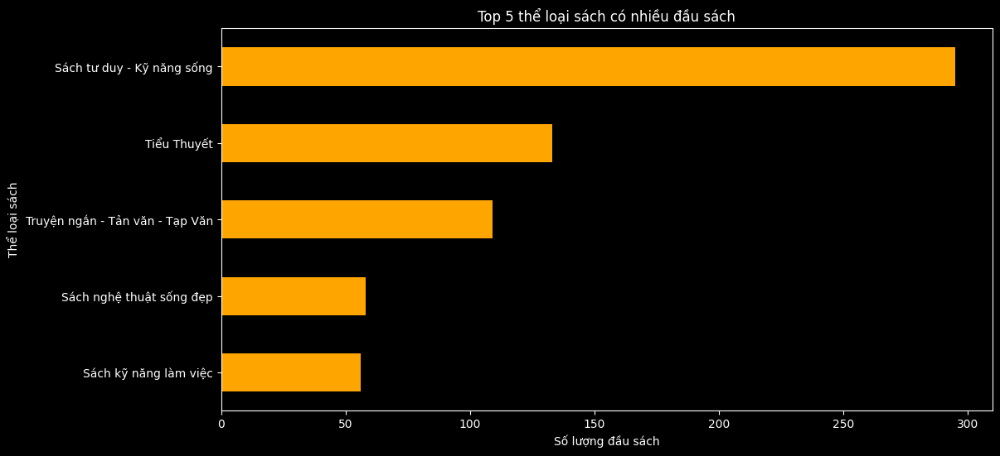

In [14]:
# Đếm số lượng sách theo thể loại
category_counts = df['category'].value_counts()

# Vẽ biểu đồ cột ngang
plt.figure(figsize=(12, 6))
category_counts[:5].plot(kind='barh', color='orange')
plt.ylabel("Thể loại sách")
plt.xlabel("Số lượng đầu sách")
plt.title("Top 5 thể loại sách có nhiều đầu sách")
plt.gca().invert_yaxis()

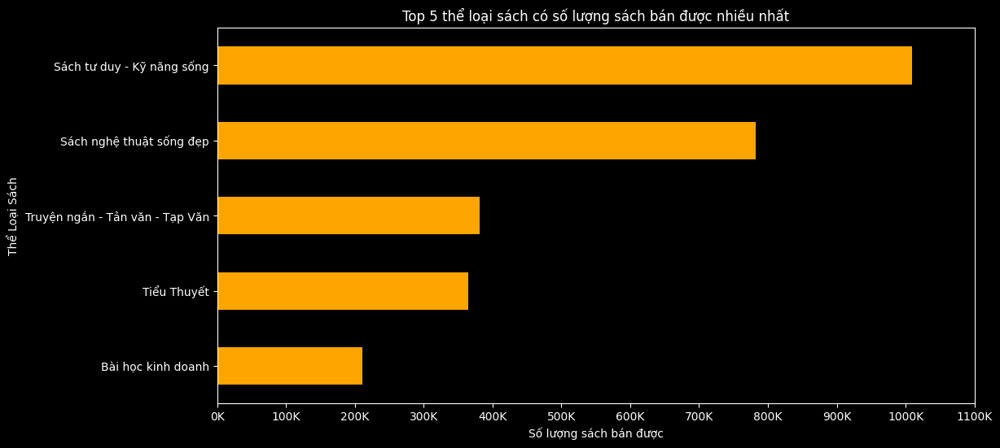

In [15]:
# Lấy top 5 thể loại sách có số lượng bán nhiều nhất
top_categories = df.groupby("category")["quantity"].sum().nlargest(5)
top_categories = top_categories.astype(int)

# Khoảng tối đa trên trục x
max_quantity = int(np.ceil(top_categories.max() / 1000) * 1000)

# Xác định khoảng cách bước
step_size = 100000 if max_quantity > 500000 else 50000

# Định nghĩa hàm format_thousands để định dạng nhãn trục x
def format_thousands(x, pos):
    return f'{int(x/1000)}K'

# Vẽ biểu đồ cột ngang với trục X là bội số của 100K
plt.figure(figsize=(12, 6))
bars = top_categories.plot(kind="barh", color="orange")
plt.title("Top 5 thể loại sách có số lượng sách bán được nhiều nhất")
plt.xlabel("Số lượng sách bán được")
plt.ylabel("Thể Loại Sách")
plt.gca().invert_yaxis()

# Chia trục x theo bội số của 100K
plt.xticks(ticks=np.arange(0, max_quantity + step_size, step_size))
plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(format_thousands))
plt.show()


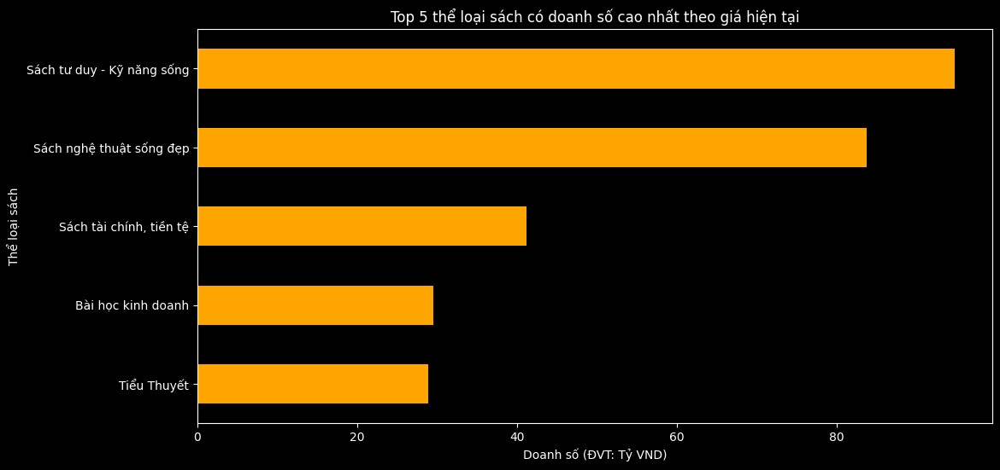

In [16]:
# Tính doanh số bán ra (doanh số) theo thể loại sách
category_revenue = (df.groupby('category')['revenue'].sum() / 1e9).sort_values(ascending=False).head(5)

# Vẽ biểu đồ cột ngang
plt.figure(figsize=(12, 6))
category_revenue.plot(kind='barh', color='orange')
plt.xlabel("Doanh số (ĐVT: Tỷ VND)")
plt.ylabel("Thể loại sách")
plt.title("Top 5 thể loại sách có doanh số cao nhất theo giá hiện tại")
plt.gca().invert_yaxis()
# Hiển thị biểu đồ
plt.show()


### 3. Phân Tích Doanh Số Theo Thể Loại Sách

Thị trường sách luôn vận động theo thị hiếu bạn đọc, và dữ liệu từ các sàn thương mại điện tử đã cho thấy những xu hướng thú vị.

Top 3 thể loại có nhiều đầu sách nhất

1. Sách tư duy – Kỹ năng sống

2. Tiểu thuyết

3. Truyện ngắn – Tản văn – Tạp văn

Top 3 thể loại có số lượng sách bán ra nhiều nhất

1. Sách tư duy – Kỹ năng sống

2. Sách nghệ thuật sống đẹp

3. Truyện ngắn – Tản văn – Tạp văn

Top 3 thể loại có doanh số cao nhất

1. Sách tư duy – Kỹ năng sống

2. Sách nghệ thuật sống đẹp

3. Sách tài chính, tiền tệ

Phân Tích Xu Hướng

💡Sách tư duy – Kỹ năng sống: 

Thể loại này không chỉ có số lượng đầu sách nhiều nhất mà còn đứng đầu về số lượng bán và doanh số. Một phần lý do có thể đến từ đối tượng khách hàng trên sàn thương mại điện tử: phần lớn là người trẻ, nhạy bén với thông tin, luôn muốn học hỏi và hoàn thiện bản thân.

💡Tiểu thuyết: 

Mặc dù có số lượng đầu sách nhiều thứ hai, tiểu thuyết lại không lọt vào top 3 thể loại bán chạy hay có doanh số cao. Điều này cho thấy việc tăng đầu sách trong thể loại này không phải là chiến lược tối ưu để tăng doanh số.

💡Truyện ngắn – Tản văn – Tạp văn: 

Đứng trong top 3 cả về số lượng đầu sách lẫn số lượng bán ra, thể loại này chứng minh rằng ngoài việc đọc sách để học hỏi, nhiều người vẫn tìm đến sách như một cách giải trí, thư giãn.

💡Sách nghệ thuật sống đẹp: 

Dù không có số lượng đầu sách nhiều, thể loại này vẫn duy trì vị trí thứ 2 về cả số lượng bán ra và doanh số. Điều này cho thấy sự ổn định và tiềm năng lớn nếu được khai thác đúng cách.

💡Sách tài chính, tiền tệ:

Đây có lẽ là điểm bất ngờ nhất! Không nằm trong top thể loại có nhiều đầu sách hay bán chạy nhất, nhưng lại vững vàng ở vị trí thứ 3 về doanh số. Điều này chứng tỏ rằng sách tài chính có một nhóm bạn đọc rất trung thành và sẵn sàng chi tiêu mạnh tay. Đây có thể là một thị trường chưa được khai thác hết tiềm năng. Để có cái nhìn chi tiết hơn về tiềm năng của dòng sách kinh tế chúng ta sẽ đến lát cắt tiếp theo.

#### 🔎Chiến lược về dòng sách cho nhà xuất bản:

📌Dòng sách tài chính, tiền tệ đang là mỏ kim cương với doanh số tốt nhưng chưa có nhiều NXB khai thác thông qua số liệu về số lượng đầu sách và số lượng sách bán ra. Dư địa tăng trưởng nhóm này vẫn còn lớn!

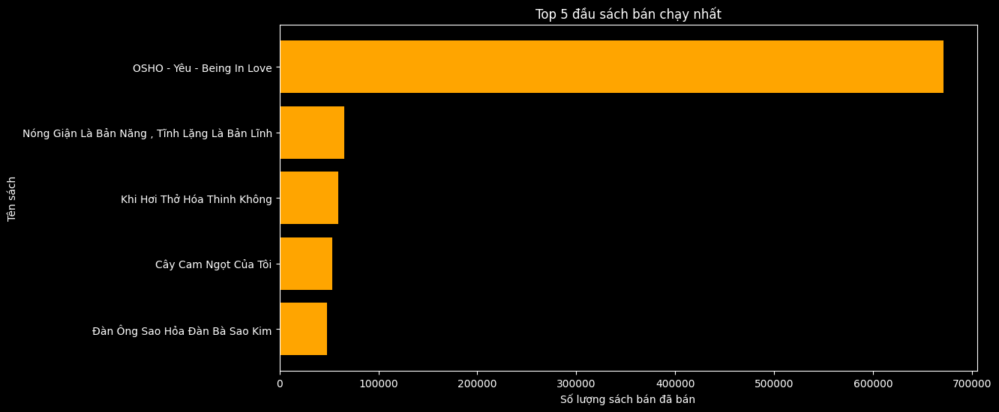

In [17]:
# Lọc top 5 sách bán chạy nhất
top_selling_books = df.nlargest(5, 'quantity')[['title', 'quantity']]

# Vẽ biểu đồ
plt.figure(figsize=(12, 6))
plt.barh(top_selling_books['title'], top_selling_books['quantity'], color='orange')
plt.xlabel("Số lượng sách bán đã bán")
plt.ylabel("Tên sách")
plt.title("Top 5 đầu sách bán chạy nhất")
plt.gca().invert_yaxis()
plt.show()

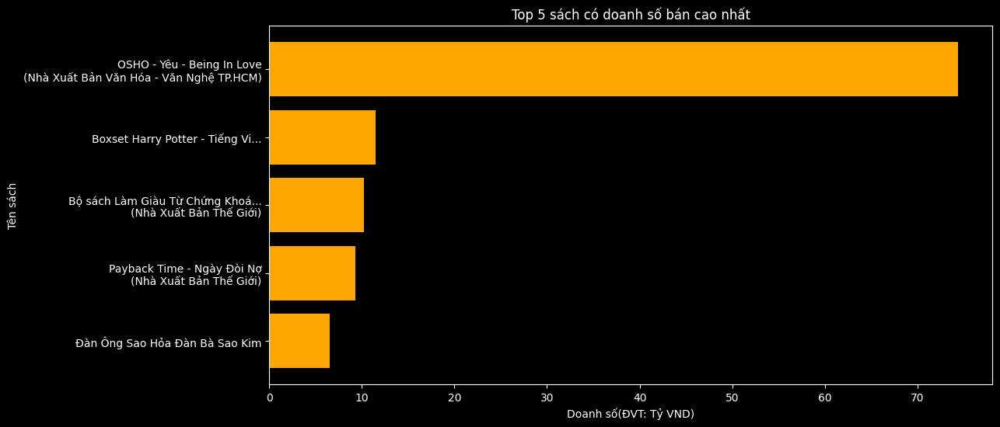

In [18]:
# Lọc top 5 sách có doanh số bán cao nhất
top_revenue_books = df.nlargest(5, 'revenue')[['title', 'revenue', 'manufacturer']]

# Chuyển sang đơn vị tỷ đồng
top_revenue_books['revenue'] = top_revenue_books['revenue'] / 1_000_000_000

# Rút gọn nếu tên sách quá dài
top_revenue_books['short_title'] = top_revenue_books['title'].apply(lambda x: x[:30] + '...' if len(x) > 30 else x)

# Tạo nhãn mới kết hợp tên sách và nhà xuất bản (nếu có)
top_revenue_books['label'] = top_revenue_books.apply(
    lambda row: f"{row['short_title']}\n({row['manufacturer']})" if pd.notna(row['manufacturer']) else row['short_title'], axis=1
)

# Vẽ biểu đồ
plt.figure(figsize=(12, 6))
plt.barh(top_revenue_books['label'], top_revenue_books['revenue'], color='orange')
plt.xlabel("Doanh số(ĐVT: Tỷ VND)")
plt.ylabel("Tên sách")
plt.title("Top 5 sách có doanh số bán cao nhất")
plt.gca().invert_yaxis()
plt.show()


### 4. Phân tích doanh thu theo đầu sách
Top 5 sách bán chạy nhất

1. Osho - Yêu - Being in Love
2. Nóng Giận Là Bản Năng, Tĩnh Lặng Là Bản Lĩnh
3. Khi Hơi Thở Hoá Thinh Không
4. Cây Cam Ngọt Của Tôi
5. Đàn Ông Sao Hoả, Đàn Bà Sao Kim

Top 5 sách có doanh số cao nhất
1. Osho - Yêu - Being in Love
2. Boxset Harry Potter
3. Bộ Sách Làm Giàu Từ Chứng Khoán
4. Payback Time - Ngày Đòi Nợ
5. Đàn Ông Sao Hoả, Đàn Bà Sao Kim

💡Từ những thông tin này, có thể thấy rằng ngoài Osho - Yêu - Being in Love giữ vị trí dẫn đầu ở cả hai hạng mục về số lượng bán ra và doanh số, các vị trí tiếp theo lại có sự thay đổi đáng kể.

💡Nếu xét về doanh số, hai cuốn sách về tài chính là Bộ Sách Làm Giàu Từ Chứng Khoán và Payback Time - Ngày Đòi Nợ tuy không nằm trong top bán chạy nhưng vẫn góp mặt trong danh sách doanh số cao nhất. Điều này cho thấy dù số lượng bán ra không quá áp đảo, giá trị của từng cuốn sách lại rất cao, giúp chúng giữ vững vị trí trong bảng xếp hạng doanh số.

💡Từ đây, một câu hỏi thú vị được đặt ra: Giữa Nhà Xuất Bản Thế Giới và Nhà Xuất Bản Văn Hoá - Văn Nghệ TP.HCM, đâu mới là đơn vị có tổng doanh số cao nhất?

💡Cán cân có vẻ nghiêng về một phía khi NXB Văn Hoá - Văn Nghệ TP.HCM đang sở hữu Osho – "gà đẻ trứng kim cương", với lượng sách bán ra lẫn doanh số đều dẫn đầu. Và chúng ta sẽ đến lát cắt thú vị tiếp theo để trả lời.

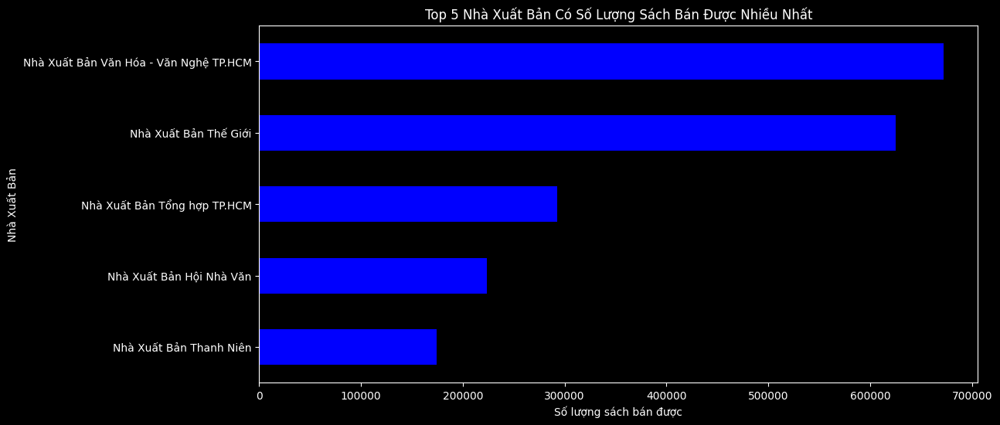

In [19]:
# Loại bỏ các nhà xuất bản có giá trị "unknown" hoặc rỗng
df_cleaned = df[df['manufacturer'].notna() & (df['manufacturer'].str.lower() != 'unknown')]
# Nhóm đếm số lượng sách bán ra theo nhà xuất bản
top_publishers = df.groupby("manufacturer")["quantity"].sum().nlargest(5)
 
# Vẽ biểu đồ
plt.figure(figsize=(12, 6))
top_publishers.plot(kind="barh", color="blue")
plt.title("Top 5 Nhà Xuất Bản Có Số Lượng Sách Bán Được Nhiều Nhất")
plt.xlabel("Số lượng sách bán được")
plt.ylabel("Nhà Xuất Bản")
plt.gca().invert_yaxis()
plt.show()

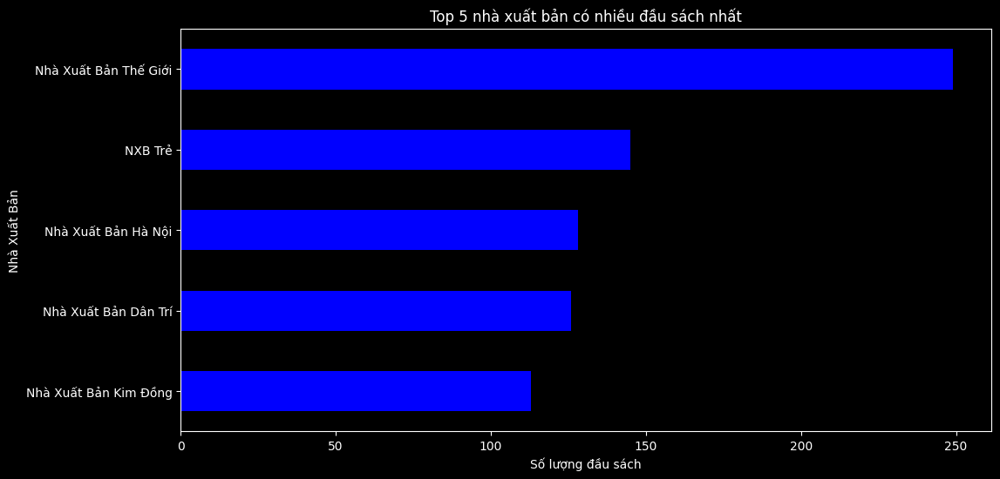

In [20]:

# Loại bỏ các nhà xuất bản có giá trị "unknown" hoặc rỗng
df_cleaned = df[df['manufacturer'].notna() & (df['manufacturer'].str.lower() != 'unknown')]

# Đếm số lượng đầu sách theo nhà xuất  (*Đầu sách là số lượng tác phẩm mà nhà xuất bản đó đang phát hành, không phải số cuốn sách đang bán ra trên sàn)
publisher_counts_cleaned = df_cleaned['manufacturer'].value_counts()

# Vẽ biểu đồ top 5 nhà xuất bản có nhiều đầu sách nhất
plt.figure(figsize=(12, 6))
ax = publisher_counts_cleaned[:5].plot(kind='barh', color='blue')
plt.xlabel("Số lượng đầu sách")
plt.ylabel("Nhà Xuất Bản")
plt.title("Top 5 nhà xuất bản có nhiều đầu sách nhất")
plt.gca().invert_yaxis()
plt.show()

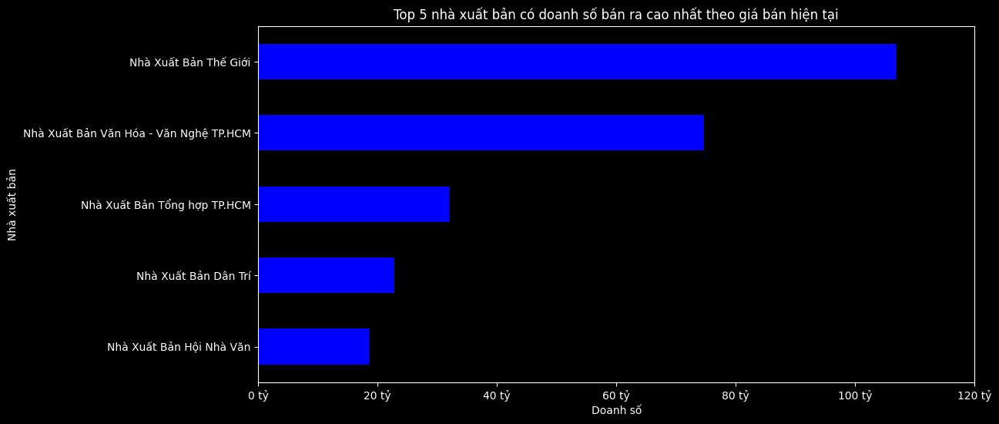

In [21]:
# Tính doanh số bán ra (doanh số dựa trên giá bán hiện tại (giá bán trên sàn)
df['revenue'] = df['current_price'] * df['quantity']

# Top 5 doanh số bán ra (doanh số theo nhà xuất bản
publisher_revenue = df.groupby('manufacturer')['revenue'].sum().nlargest(5)

# Vẽ biểu đồ cột ngang
plt.figure(figsize=(12, 6))
publisher_revenue.plot(kind='barh', color='blue')
plt.xlabel("Doanh số")
plt.ylabel("Nhà xuất bản")
plt.title("Top 5 nhà xuất bản có doanh số bán ra cao nhất theo giá bán hiện tại")
plt.gca().invert_yaxis()
# Thiết lập thang đo doanh số theo bội số của 20 tỷ
plt.xticks(ticks=range(0, int(publisher_revenue.max()) + 20_000_000_000, 20_000_000_000),
           labels=[f"{x // 1_000_000_000} tỷ" for x in range(0, int(publisher_revenue.max()) + 20_000_000_000, 20_000_000_000)])

plt.show()

### 5. Phân tích doanh số theo nhà xuất bản

Top 5 Nhà Xuất Bản có số lượng sách bán được nhiều nhất
1. Nhà Xuất Bản Văn Hoá - Văn Nghệ TP.HCM
2. Nhà Xuất Bản Thế Giới
3. Nhà Xuất Bản Tổng Hợp TP.HCM
4. Nhà Xuất Bản Hội Nhà Văn
5. Nhà Xuất Bản Thanh Niên

Top 5 Nhà Xuất Bản có nhiều đầu sách nhất
1. Nhà Xuất Bản Thế Giới
2. Nhà Xuất Bản Trẻ
3. Nhà Xuất Bản Hà Nội
4. Nhà Xuất Bản Dân Trí
5. Nhà Xuất Bản Kim Đồng

Top 5 Nhà Xuất Bản có doanh số bán ra cao nhất
1. Nhà Xuất Bản Thế Giới
2. Nhà Xuất Bản Văn Hoá - Văn Nghệ TP.HCM
3. Nhà Xuất Bản Tổng Hợp TP.HCM
4. Nhà Xuất Bản Dân Trí
5. Nhà Xuất Bản Hội Nhà Văn


💡 Từ những thông tin trên, có thể thấy rằng Nhà Xuất Bản Văn Hoá - Văn Nghệ TP.HCM dẫn đầu về số lượng sách bán ra, nhưng lại không nằm trong nhóm các NXB có nhiều đầu sách nhất. Điều này cho thấy họ tập trung vào một số tác giả hoặc dòng sách chủ lực, thay vì trải rộng danh mục sách. Vì vậy, họ vẫn đứng thứ hai về doanh số bán ra.


💡Ông trùm trong ngành xuất bản đã lộ diện, Nhà Xuất Bản Thế Giới đang giữ một vị thế đáng gờm. Đứng thứ hai về số lượng sách bán ra, nhưng hai vị trí quan trọng nhất họ đã nắm trọn, nhà xuất bản có nhiều đầu sách và vị trí số một doanh số. Điều này cho thấy sự kết hợp giữa danh mục sách phong phú và chiến lược bán hàng hiệu quả đã giúp có được vị thế vững chắc.


💡Thị trường xuất bản cạnh tranh khốc liệt, không chỉ ở số lượng đầu sách mà còn ở cách tiếp cận đọc giả. Vậy đâu là chìa khóa thành công của Nhà Xuất Bản Thế Giới? Luật chơi hiện tại là gì? Đây có thể là một gợi ý quan trọng để các nhà xuất bản khác điều chỉnh chiến lược để gia tăng doanh số và mở rộng thị trường. Chúng ta sẽ tìm hiểu tiếp theo sau.

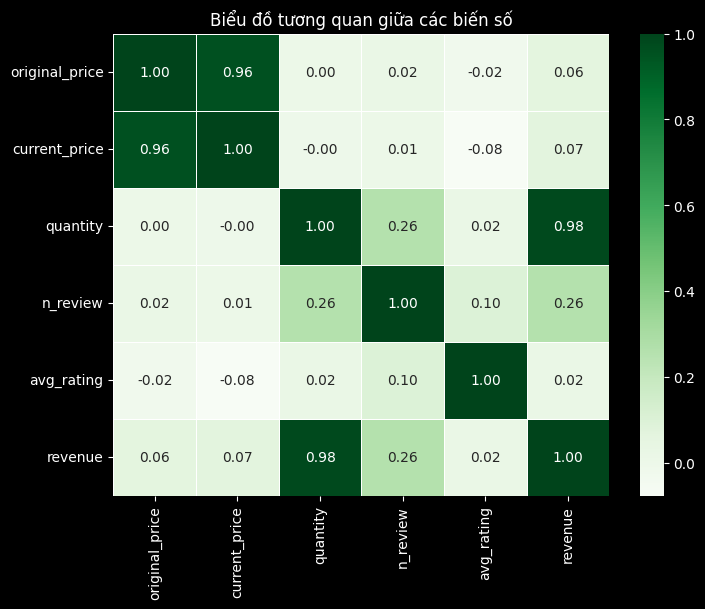

In [22]:
# Chọn các cột số để tính ma trận tương quan
numeric_columns = ['original_price', 'current_price', 'quantity', 'n_review', 'avg_rating', 'pages', 'revenue']
df_corr = df_cleaned[numeric_columns].corr()

# Vẽ biểu đồ heatmap để hiển thị ma trận tương quan
plt.figure(figsize=(8, 6))
sns.heatmap(df_corr, annot=True, cmap='Greens', fmt=".2f", linewidths=0.5)
plt.title("Biểu đồ tương quan giữa các biến số")
plt.show()

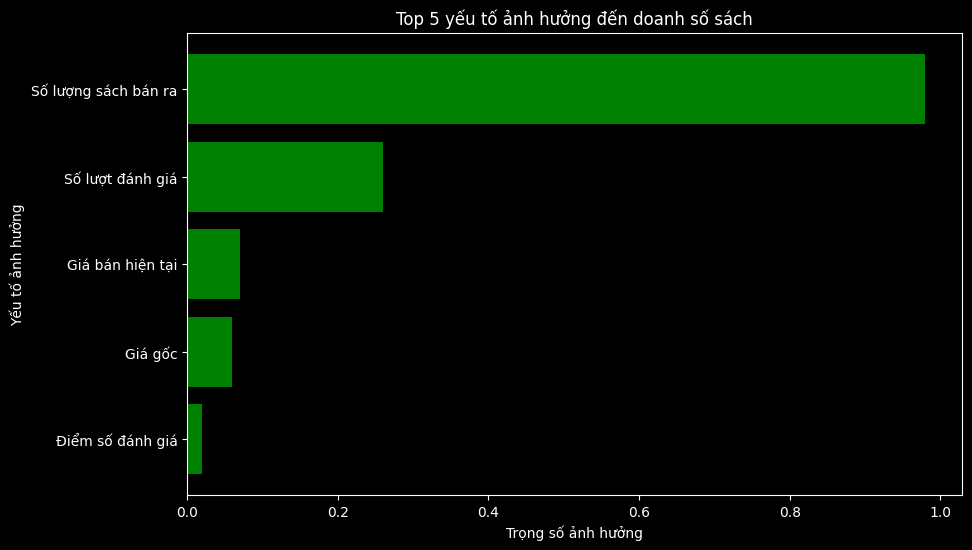

In [23]:
# Dữ liệu về trọng số ảnh hưởng đến doanh số
factors = ["Số lượng sách bán ra", "Số lượt đánh giá", "Giá bán hiện tại", "Giá gốc", "Điểm số đánh giá"]
weights = [0.98, 0.26, 0.07, 0.06, 0.02]

# Vẽ biểu đồ thanh
plt.figure(figsize=(10, 6))
plt.barh(factors[::-1], weights[::-1], color='green')
plt.xlabel("Trọng số ảnh hưởng")
plt.ylabel("Yếu tố ảnh hưởng")
plt.title("Top 5 yếu tố ảnh hưởng đến doanh số sách")
plt.show()

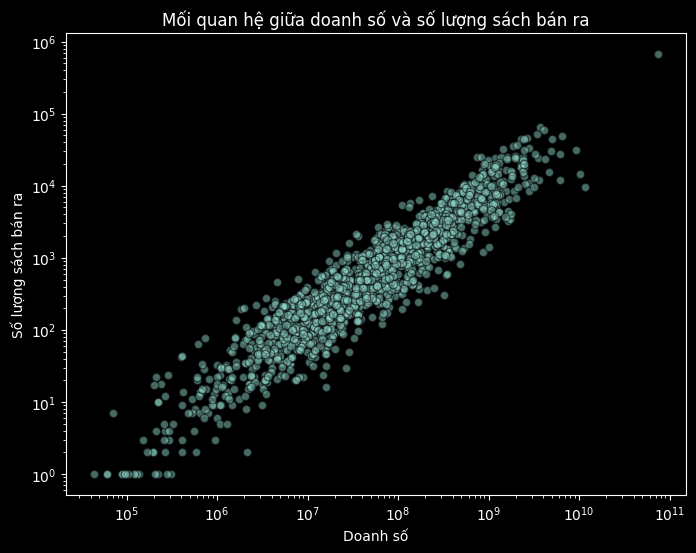

In [24]:
# Vẽ biểu đồ scatter giữa số lượng đánh giá và số sách bán ra
plt.figure(figsize=(8, 6))
plt.scatter(df['revenue'], df['quantity'], alpha=0.5, edgecolors='black')
plt.xlabel("Doanh số")
plt.ylabel("Số lượng sách bán ra")
plt.title("Mối quan hệ giữa doanh số và số lượng sách bán ra")
plt.xscale("log") 
plt.yscale("log")
plt.grid(False)
plt.show()

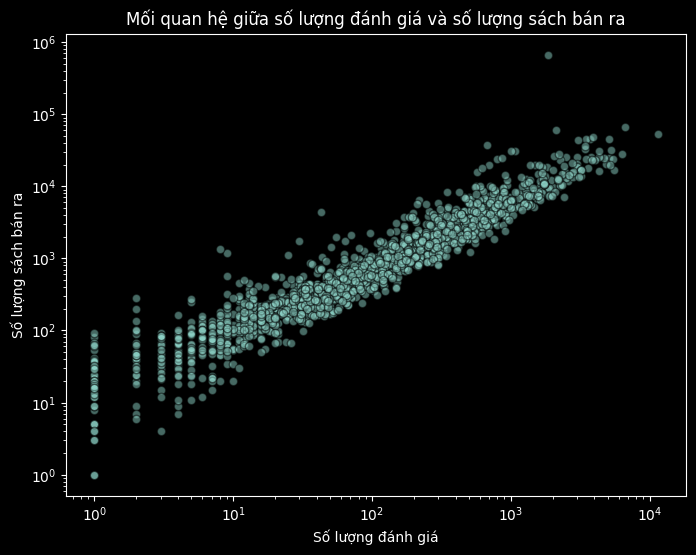

In [25]:
# Vẽ biểu đồ scatter giữa số lượng đánh giá và số sách bán ra
plt.figure(figsize=(8, 6))
plt.scatter(df['n_review'], df['quantity'], alpha=0.5, edgecolors='black')
plt.xlabel("Số lượng đánh giá")
plt.ylabel("Số lượng sách bán ra")
plt.title("Mối quan hệ giữa số lượng đánh giá và số lượng sách bán ra")
plt.xscale("log") 
plt.yscale("log")
plt.grid(False)
plt.show()

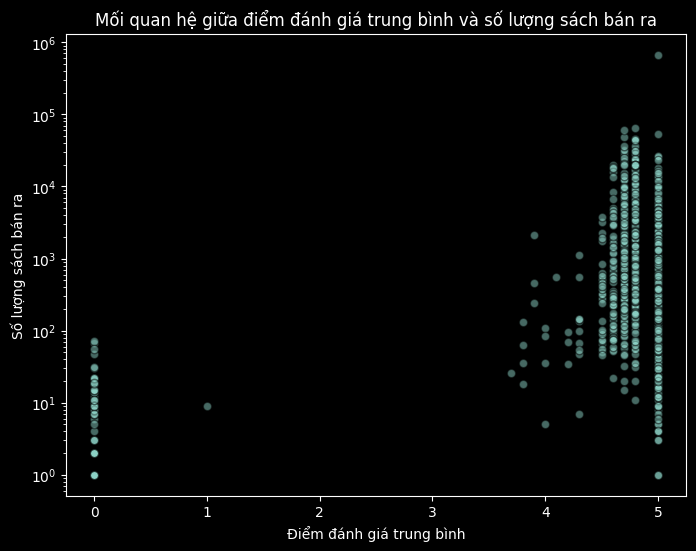

In [26]:
# Vẽ biểu đồ scatter giữa điểm đánh giá trung bình và số lượng sách bán ra
plt.figure(figsize=(8, 6))
plt.scatter(df['avg_rating'], df['quantity'], alpha=0.5, edgecolors='black')
plt.xlabel("Điểm đánh giá trung bình")
plt.ylabel("Số lượng sách bán ra")
plt.title("Mối quan hệ giữa điểm đánh giá trung bình và số lượng sách bán ra")
plt.yscale("log")
plt.grid(False)
plt.show()


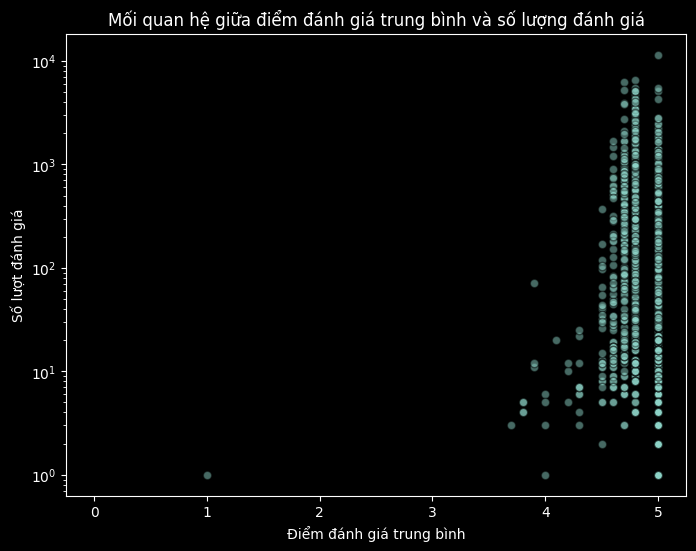

In [27]:
# Vẽ biểu đồ scatter giữa điểm đánh giá trung bình và số lượng đánh giá
plt.figure(figsize=(8, 6))
plt.scatter(df['avg_rating'], df['n_review'], alpha=0.5, edgecolors='black')
plt.xlabel("Điểm đánh giá trung bình")
plt.ylabel("Số lượt đánh giá")
plt.title("Mối quan hệ giữa điểm đánh giá trung bình và số lượng đánh giá")
plt.yscale("log") 
plt.grid(False)
plt.show()

#### 6. Phân Tích Tương Quan Giữa Các Biến Số Ảnh Hưởng Đến Doanh Số Từng Đầu Sách Của Các Nhà Xuất Bản

Dựa trên biểu đồ tương quan, các yếu tố ảnh hưởng đến doanh số sách được sắp xếp theo mức độ quan trọng giảm dần:

Top 5 yếu tố có trọng số ảnh hưởng lớn nhất đến doanh số
(Trọng số càng cao, mức độ ảnh hưởng càng lớn)
1. Số lượng sách bán ra (0.98)
2. Số lượt đánh giá (0.26)
3. Giá bán hiện tại (0.07)
4. Giá gốc (0.06)
5. Điểm số đánh giá (0.02)

Biểu đồ scatter giữa các biến số sẽ giúp minh họa rõ hơn mối quan hệ này và lý giải kết quả thu được.

💡 Số lượng sách bán ra - Yếu tố quyết định hàng đầu

Số lượng sách bán ra có ảnh hưởng mạnh mẽ nhất đến doanh số thể. Dù mỗi bạn đọc có sở thích riêng, nhưng một cuốn sách bán chạy đồng nghĩa với việc nó phù hợp với thị hiếu chung của đông đảo bạn đọc.

💡 Số lượt đánh giá - Yếu tố tác động đến tâm lý đám đông

Số lượt đánh giá cũng đóng vai trò quan trọng, ảnh hưởng đến quyết định mua sách của nhiều người. Khi sách có nhiều đánh giá, hiệu ứng lan tỏa sẽ giúp thu hút thêm người mua. Bạn đọc sau khi đọc và thấy sách hay thường quay lại đánh giá, từ đó tạo nên vòng lặp tích cực.

💡 Giá bán và mức chiết khấu - Ảnh hưởng nhưng không quá lớn

Các đầu sách có mức giá chiết khấu sẽ hấp dẫn hơn, dẫn đến doanh số nhỉnh hơn so với những cuốn giữ nguyên giá gốc. Tuy nhiên, sự chênh lệch này không quá đáng kể, thể hiện qua trọng số của giá chiết khấu (0.07) và giá gốc (0.06).

💡 Điểm số đánh giá - Chất lượng sách không phải lúc nào cũng tỉ lệ thuận với doanh số

Mặc dù điểm đánh giá thể hiện chất lượng sách, nhưng nó lại không có ảnh hưởng đáng kể đến doanh số. Lý do là vì phần lớn sách trên sàn đều có mức đánh giá cao, dao động chủ yếu từ 4.5 đến 5.0, thay vì có sự phân bố đều từ 0 đến 5.

💡 Sách hay chưa chắc đã bán chạy, sách dở cũng chưa chắc đã bị đánh giá thấp

Một điều thú vị là dù có nội dung hay và được đánh giá cao, nhưng nếu sách kén người đọc thì doanh số vẫn không cao. Ngược lại, những cuốn sách có nội dung phù hợp, dễ tiếp cận, lại có thể thu hút nhiều bạn đọc hơn.

Trong khi đó, những cuốn sách không chất lượng thấp thường bị đánh giá 1 điểm, hoặc dở quá không ai thèm đánh giá, đa phần người đọc khi không hài lòng với sách thường sẽ không đánh giá, dẫn đến một hiện tượng có sách 0 điểm, lượng bán không cao và cũng không hề có lượt đánh giá ở mức 0 điểm.

#### 🔎Chiến lược chọn đầu sách cho nhà xuất bản:

📌Để tối ưu doanh số, nhà xuất bản cần lựa chọn các đầu sách đáp ứng được thị hiếu số đông, không nên chỉ tập trung vào những cuốn sách mang tính hàn lâm hay kén bạn đọc. Sách hay chưa chắc bán chạy, nhưng sách phù hợp với nhiều người thì chắc chắn có doanh số tốt.

📌Ngoài ra, cần tạo ra sự tương tác tốt với bạn đọc thông qua việc khuyến khích đánh giá và phản hồi. Một cuốn sách có nhiều đánh giá tích cực, mức giá hợp lý và nội dung gần gũi với số đông sẽ có khả năng đạt doanh số cao hơn.

📌Chúng ta đã có công thức thành công cho một đầu sách vậy tổng thể Nhà Xuất Bản Thế Giới đã làm tốt đến thế nào để dẫn đầu về nhà xuất bản có doanh số cao nhất. Cùng tìm hiểu thêm các phân tích tiếp theo!


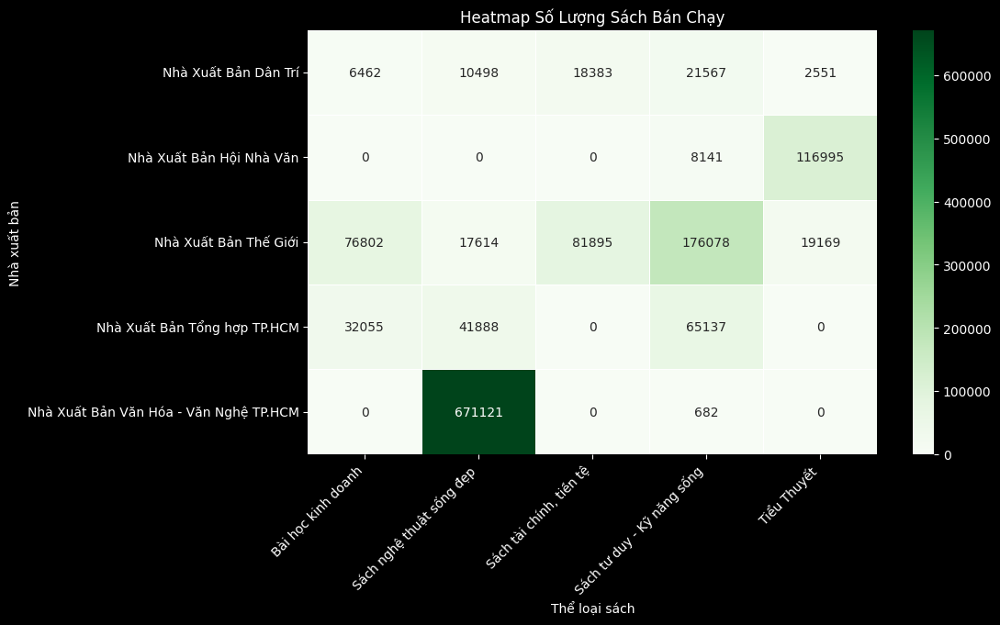

In [28]:
# Top 5 nhà xuất bản có doanh số bán sách cao nhất
top_publishers = df.groupby('manufacturer')['revenue'].sum().nlargest(5).index

# Top 5 thể loại có doanh số cao nhất
top_categories = df.groupby('category')['revenue'].sum().nlargest(5).index

# Lọc Theo top nhà xuất bản và top thể loại
filtered_df = df[(df['manufacturer'].isin(top_publishers)) & (df['category'].isin(top_categories))]

# Tính tổng số lượng sách bán ra theo nhà xuất bản và thể loại sách
heatmap_quantity = filtered_df.pivot_table(values='quantity', index='manufacturer', columns='category', aggfunc='sum', fill_value=0)

# Vẽ heatmap thể hiện số lượng sách bán ra
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_quantity, annot=True, fmt=".0f", cmap="Greens", linewidths=0.5)
plt.xlabel("Thể loại sách")
plt.ylabel("Nhà xuất bản")
plt.title("Heatmap Số Lượng Sách Bán Chạy")
plt.xticks(rotation=45, ha='right')
plt.show()


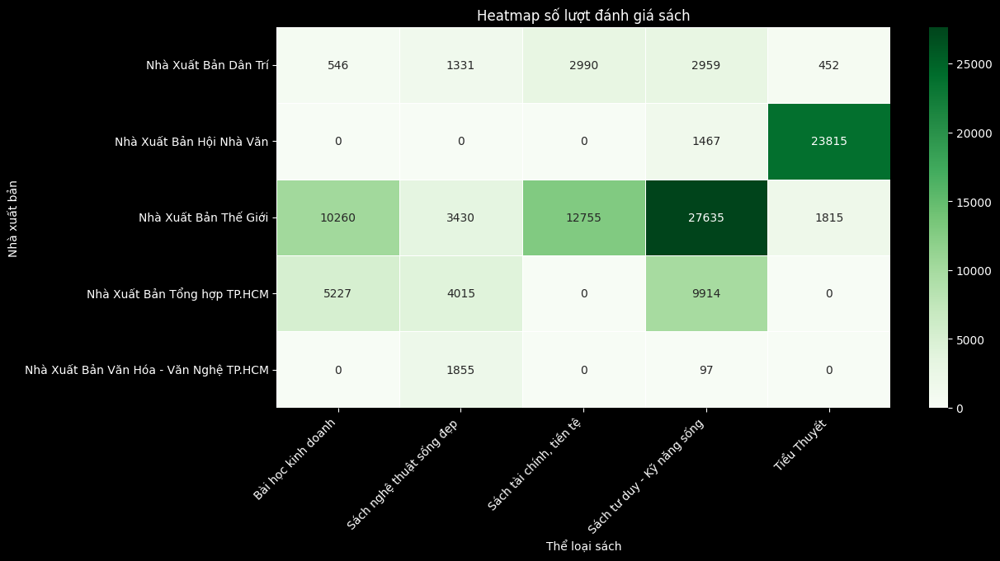

In [29]:
# Top 5 nhà xuất bản có doanh số bán sách cao nhất
top_publishers = df.groupby('manufacturer')['revenue'].sum().nlargest(5).index

# Top 5 thể loại có doanh số cao nhất
top_categories = df.groupby('category')['revenue'].sum().nlargest(5).index

# Lọc Theo top nhà xuất bản và top thể loại
filtered_df = df[(df['manufacturer'].isin(top_publishers)) & (df['category'].isin(top_categories))]

# Tạo bảng pivot để biểu diễn số lượng đánh giá giữa nhà xuất bản và thể loại sách
heatmap_n_review = filtered_df.pivot_table(values='n_review', index='manufacturer', columns='category', aggfunc='sum', fill_value=0)

# Vẽ biểu đồ heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(heatmap_n_review, annot=True, fmt=".0f", cmap="Greens", linewidths=0.5)
plt.xlabel("Thể loại sách")
plt.ylabel("Nhà xuất bản")
plt.title("Heatmap số lượt đánh giá sách")
plt.xticks(rotation=45, ha='right')
plt.show()


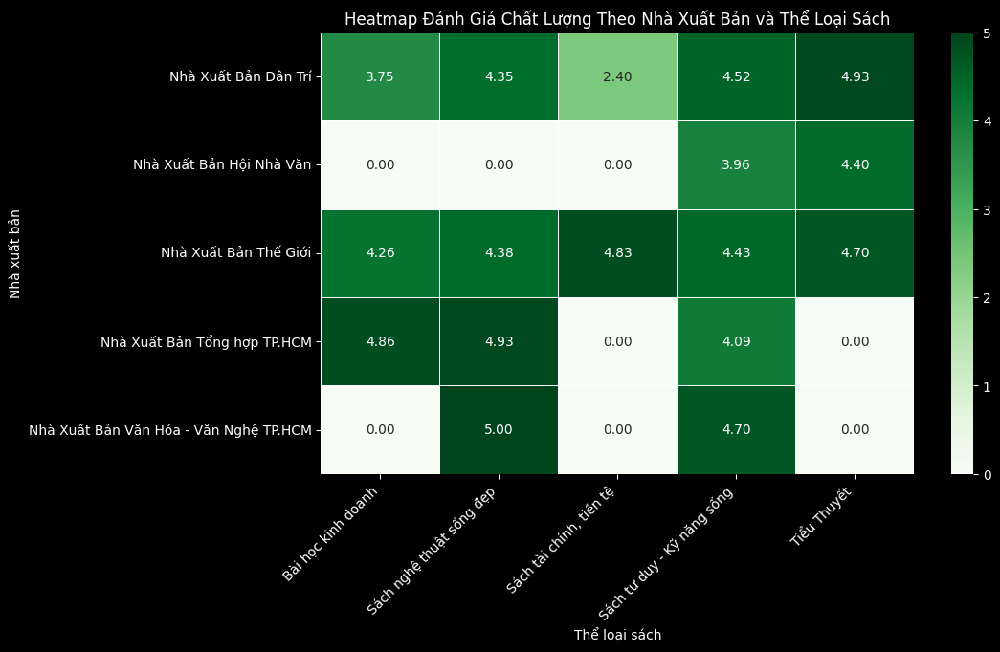

In [30]:
# Top 5 nhà xuất bản có doanh số bán sách cao nhất
top_publishers = df.groupby('manufacturer')['revenue'].sum().nlargest(5).index

# Top 5 thể loại có doanh số cao nhất
top_categories = df.groupby('category')['revenue'].sum().nlargest(5).index

# Lọc Theo top nhà xuất bản và top thể loại
filtered_df = df[(df['manufacturer'].isin(top_publishers)) & (df['category'].isin(top_categories))]

# Tạo bảng pivot để vẽ heatmap
heatmap_avg_rating = filtered_df.pivot_table(values='avg_rating', index='manufacturer', columns='category', aggfunc='mean', fill_value=0)

# Vẽ heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_avg_rating, annot=True, fmt=".2f", cmap="Greens", linewidths=0.5)
plt.xlabel("Thể loại sách")
plt.ylabel("Nhà xuất bản")
plt.title("Heatmap Đánh Giá Chất Lượng Theo Nhà Xuất Bản và Thể Loại Sách")
plt.xticks(rotation=45, ha='right')
plt.show()

### 7. Phân tích sự thành công của Nhà Xuất Bản Thế Giới - Qua biểu đồ Heatmap

Biểu đồ Heat Map thể hiện sự tương quan giữa top 5 nhà xuất bản có doanh số cao nhất và top 5 thể loại sách có doanh số bán tốt nhất. Dựa trên các biến số như số lượng sách bán ra, lượt đánh giá và điểm đánh giá, chúng ta có thể làm rõ hơn những yếu tố góp phần tạo nên thành công của Nhà Xuất Bản Thế Giới.

💡 Chiến lược dàn trải danh mục sách - NXB Thế Giới vs. NXB Văn Hoá - Văn Nghệ TP.HCM

Dữ liệu từ Heat Map cho thấy NXB Thế Giới có số lượng sách bán chạy phân bổ đồng đều trên nhiều thể loại, thay vì chỉ tập trung mạnh vào một dòng sách nhất định như NXB Văn Hoá - Văn Nghệ TP.HCM. Đây là một chiến lược quan trọng giúp NXB Thế Giới duy trì lợi thế về doanh số, đồng thời mở rộng tập khách hàng một cách hiệu quả hơn so với các nhà xuất bản còn lại.

💡 NXB Thế Giới vs. NXB Dân Trí - Lượt đánh giá và tác động đến doanh số

Ngoài NXB Thế Giới, NXB Dân Trí cũng có danh mục sách bán chạy trải rộng qua nhiều thể loại "hot". Tuy nhiên, sự khác biệt lớn nhất dẫn đến khoảng cách về doanh số giữa hai nhà xuất bản này chính là lượt đánh giá từ bạn đọc.

Sách của NXB Thế Giới có số lượt đánh giá vượt trội hơn hẳn, đặc biệt là trong thể loại Sách Tư Duy - Kỹ Năng Sống. Điều này có thể lý giải rằng hiệu ứng tâm lý đám đông đóng vai trò quan trọng: sách có nhiều lượt đánh giá tạo sự tin tưởng và dễ dàng thu hút thêm người mua.

💡 Chất lượng sách - Yếu tố giúp NXB Thế Giới chiếm ưu thế trong chiến lược dàn trải

Một yếu tố quan trọng khác là điểm đánh giá trung bình của các thể loại sách thuộc NXB Thế Giới cao hơn và đồng đều hơn so với NXB Dân Trí.

NXB Dân Trí có một số thể loại có chất lượng trung bình với điểm đánh giá khá thấp, chẳng hạn:

Bài học kinh doanh: 3.75/5

Tài chính, tiền tệ: 2.5/5

Trong khi đó, NXB Thế Giới có điểm đánh giá cao hơn trên tất cả các thể loại, với mức trung bình trên 4.2. Điều này cho thấy không chỉ có lượng sách bán ra nhiều, mà chất lượng nội dung cũng được đánh giá cao hơn, góp phần củng cố vị thế của họ trên thị trường.


#### 🔎Từ phân tích trên, có thể rút ra một số yếu tố quan trọng giúp NXB Thế Giới đạt doanh số vượt trội:

📌Phân bổ danh mục sách hợp lý, đa dạng thể loại thay vì chỉ tập trung vào một mảng.

📌Số lượt đánh giá cao giúp tạo hiệu ứng lan truyền và thúc đẩy doanh số.

📌Chất lượng sách ổn định, đạt điểm đánh giá cao hơn so với đối thủ cạnh tranh.

📌Những yếu tố này giúp NXB Thế Giới giữ vững vị trí dẫn đầu trên thị trường, đồng thời là mô hình đáng tham khảo cho các nhà xuất bản khác muốn tối ưu chiến lược kinh doanh của mình.

Khi đã tìm ra mô hình hoàn chỉnh để có thể có doanh số cao trên sàn Tiki. Chắc chắn chúng ta sẽ khổng thể không tò mò top các cuốn sách đóng góp doanh số cao nhất cho các nhà xuất bản. Điều này sẽ dẫn đến các phân tích thú vị tiếp theo!

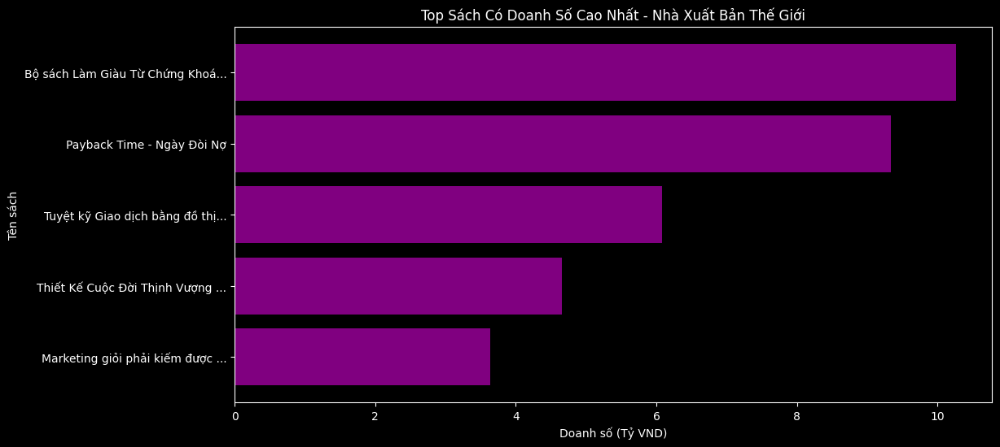

In [31]:
# Lọc top sách có doanh số cao nhất của nhà xuất bản "Nhà Xuất Bản Thế Giới"
top_books_world_publisher = df[df['manufacturer'] == "Nhà Xuất Bản Thế Giới"].nlargest(5, 'revenue')[['title', 'revenue']]

# Chuyển sang đơn vị tỷ đồng
top_books_world_publisher['revenue'] = top_books_world_publisher['revenue'] / 1_000_000_000

# Rút gọn nếu tên sách quá dài
top_books_world_publisher['short_title'] = top_books_world_publisher['title'].apply(lambda x: x[:30] + '...' if len(x) > 30 else x)

# Vẽ biểu đồ
plt.figure(figsize=(12, 6))
plt.barh(top_books_world_publisher['short_title'], top_books_world_publisher['revenue'], color='purple')
plt.xlabel("Doanh số (Tỷ VND)")
plt.ylabel("Tên sách")
plt.title("Top Sách Có Doanh Số Cao Nhất - Nhà Xuất Bản Thế Giới")
plt.gca().invert_yaxis()
plt.show()


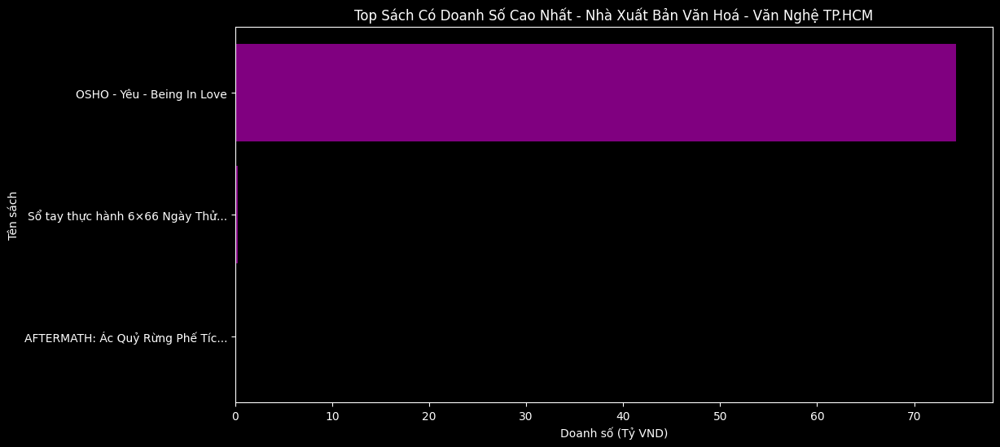

In [32]:
# Lọc top 10 sách có doanh số cao nhất của nhà xuất bản "Nhà Xuất Bản Văn Hoá Văn Nghệ TP.HCM"
top_books_van_hoa_van_nghe = df[df['manufacturer'] == "Nhà Xuất Bản Văn Hóa - Văn Nghệ TP.HCM"].nlargest(5, 'revenue')[['title', 'revenue']]

# Chuyển sang đơn vị tỷ đồng
top_books_van_hoa_van_nghe['revenue'] = top_books_van_hoa_van_nghe['revenue'] / 1_000_000_000

# Rút gọn nếu tên sách quá dài
top_books_van_hoa_van_nghe['short_title'] = top_books_van_hoa_van_nghe['title'].apply(lambda x: x[:30] + '...' if len(x) > 30 else x)

# Vẽ biểu đồ
plt.figure(figsize=(12, 6))
plt.barh(top_books_van_hoa_van_nghe['short_title'], top_books_van_hoa_van_nghe['revenue'], color='purple')
plt.xlabel("Doanh số (Tỷ VND)")
plt.ylabel("Tên sách")
plt.title("Top Sách Có Doanh Số Cao Nhất - Nhà Xuất Bản Văn Hoá - Văn Nghệ TP.HCM")
plt.gca().invert_yaxis()
plt.show()


### 8. Phân tích tình trạng doanh của của các đầu sách đóng góp nhiều cho nhà xuất bản
💡Có thể thấy bên cạnh chiến lược dàn trải nhưng vẫn chú trọng đến chất lượng làm nền tảng mở rộng tệp khách hàng và khai thác "mỏ kim cương" thể loại sách kinh tế đã giúp Nhà Xuất Bản Thế Giới tạo vị thế dẫn đầu vững chắc trên sàn Tiki.

💡Chiến lược tập trung vào đẩy mạnh các dòng tác phẩm của tác giả OSHO trong thời gian ngắn của NXB Văn Hoá - Văn Nghệ TP.HCM có thể gây dựng được vị thế tốt về doanh số nhưng đường dài có thể giảm nhanh do bão hoà. Rủi ro lớn nhất hiện tại là đầu sách đóng góp nhiều thứ 2 và thứ 3 vào doanh số của nhà xuất bản này dường như không đáng kể. NXB cần có kế hoạch tìm hướng khai thác đa dạng doanh số từ các đầu sách mới sắp tới!